In [2]:
# functions
import numpy as np
import plotly.graph_objs as go
import plotly as plt
from IPython.display import clear_output
import plotly.io as pio
import plotly.express as px

In [3]:
# import data
data_path = 'subdata.npy'
d = np.load(data_path)

In [15]:
# plot data

# NOTE: L we defined in class is 2Lh here, i.e. the domain here is [-Lh,Lh].
Lh = 10; # length of spatial domain (cube of side L = 2*10). 
N_grid = 64; # number of grid points/Fourier modes in each direction
xx = np.linspace(-Lh, Lh, N_grid+1) #spatial grid in x dir
x = xx[0:N_grid]
y = x # same grid in y,z direction
z = x

K_grid = (2*np.pi/(2*Lh))*np.linspace(-N_grid/2, N_grid/2 -1, N_grid) # frequency grid for one coordinate
Kx, Ky, Kz = np.meshgrid(K_grid, K_grid, K_grid)

xv, yv, zv = np.meshgrid( x, y, z) # generate 3D meshgrid for plotting
# use meshgrid to create a 3d grid of frequency contents, inputting the k axis to get 3d frequency grids each corresonding to kx, ky, kz at each location

# plot iso surfaces for every third measurement
for j in range(0,49,3):
    hr = j*0.5

    signal = np.reshape(d[:, j], (N_grid, N_grid, N_grid))
    normal_sig_abs = np.abs(signal)/np.abs(signal).max()

    # ggenerate data for isosurface of the 3D data 
    fig_data = go.Isosurface( x = xv.flatten(), y = yv.flatten(), z = zv.flatten(),
                            value = normal_sig_abs.flatten(), isomin=0.6, isomax=1)
    print(j)
    clear_output(wait=True) # need this to discard previous figs
    fig = go.Figure( data = fig_data )
    fig.update_layout(
    title=f"Raw Acoustic Frequency Data, Time = {hr}hr",
    scene=dict(aspectmode="cube")
    )
    fig.show()
    fig.write_image(f'og_figs/ogdata3dplot_{j}.png')


In [19]:
# go into fourier domain

d_tot = 0
for j in range(0,49):

  signal = np.reshape(d[:, j], (N_grid, N_grid, N_grid))
  d_hat = np.fft.fftn(signal, axes=None)
  d_shifted = np.fft.fftshift(d_hat)
  d_tot += d_shifted

d_avg = np.abs(d_tot / 49)

# find max frequency
dom_freq = np.max(d_avg)
kx0, ky0, kz0 = np.unravel_index(np.argmax(d_avg),d_avg.shape)
Kx0 = Kx[kx0, ky0, kz0]
Ky0 = Ky[kx0, ky0, kz0]
Kz0 = Kz[kx0, ky0, kz0]
print(f'Dominant Frequency: {dom_freq}')
print(f'Central Coordinates: {Kx0}, {Ky0}, {Kz0}')


Dominant Frequency: 176.5852044982302
Central Coordinates: 5.340707511102648, 2.199114857512855, -6.911503837897545


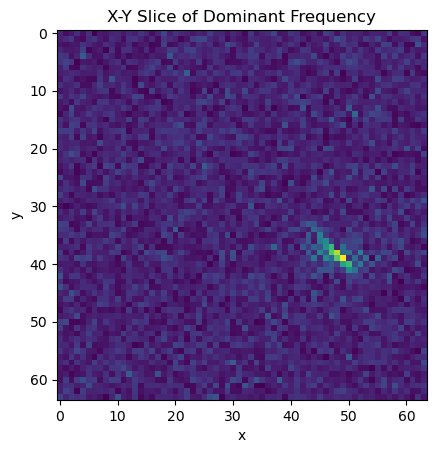

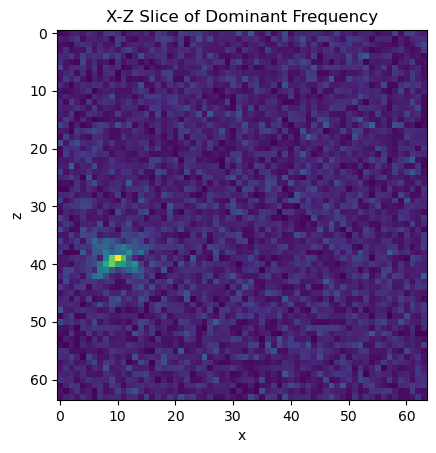

In [36]:
# make a heatmap
x_piece = d_avg[kx0,:,:]
y_piece = d_avg[:,ky0,:]
z_piece = d_avg[:,:,kz0]

plt.imshow(z_piece)
plt.xlabel('x')
plt.ylabel('y')
plt.title('X-Y Slice of Dominant Frequency')

plt.savefig('XY_Slice.png')
plt.show()

plt.imshow(y_piece)
plt.xlabel('x')
plt.ylabel('z')
plt.title('X-Z Slice of Dominant Frequency')

plt.savefig('XZ_Slice.png')
plt.show()

In [22]:
# define filter
def gaussian(Kx,Ky,Kz,s):
  tau = 1 / (2 * s**2)   
  val = np.exp(-tau*((Kx-Kx0)**2 + (Ky-Ky0)**2 + (Kz-Kz0)**2))
  return val

# add filter
path = np.zeros((3,49))
for j in range(0,49):
    signal = np.reshape(d[:, j], (N_grid, N_grid, N_grid))
    d_hat = np.fft.fftn(signal, axes=None)
    d_shifted = np.fft.fftshift(d_hat)

    # apply filter
    s = 2
    g_vals = gaussian(Kx,Ky,Kz,s)
    filt_sig_hat = d_shifted * g_vals
    filt_sig_hat_ishifted = np.fft.ifftshift(filt_sig_hat)
    filt_sig = np.fft.ifftn(filt_sig_hat_ishifted) 
    sx, sy, sz = np.unravel_index(np.argmax(np.abs(filt_sig)),np.shape(filt_sig))
    Sx = xv[sx,sy,sz]
    Sy = yv[sx,sy,sz]
    Sz = zv[sx,sy,sz]
    path[0,j] = Sx
    path[1,j] = Sy
    path[2,j] = Sz



  

[[[2.82197197e-22 3.56740708e-22 4.39983974e-22 ... 1.12321080e-35
   3.15208739e-36 8.63017179e-37]
  [9.33831149e-22 1.18050636e-21 1.45597031e-21 ... 3.71686623e-35
   1.04307109e-35 2.85584809e-36]
  [3.01486750e-21 3.81125674e-21 4.70059023e-21 ... 1.19998773e-34
   3.36754792e-35 9.22008609e-36]
  ...
  [3.49396160e-10 4.41690544e-10 5.44756336e-10 ... 1.39067838e-23
   3.90268663e-24 1.06852546e-24]
  [2.56667448e-10 3.24467174e-10 4.00179608e-10 ... 1.02159643e-23
   2.86692509e-24 7.84941945e-25]
  [1.83953337e-10 2.32545342e-10 2.86808377e-10 ... 7.32177275e-24
   2.05472272e-24 5.62567210e-25]]

 [[7.29643114e-22 9.22381243e-22 1.13761327e-21 ... 2.90415013e-35
   8.14997060e-36 2.23139900e-36]
  [2.41449410e-21 3.05229232e-21 3.76452609e-21 ... 9.61025086e-35
   2.69694260e-35 7.38402051e-36]
  [7.79517776e-21 9.85430495e-21 1.21537468e-20 ... 3.10266294e-34
   8.70706080e-35 2.38392599e-35]
  ...
  [9.03391333e-10 1.14202575e-09 1.40851048e-09 ... 3.59570865e-23
   1.00907

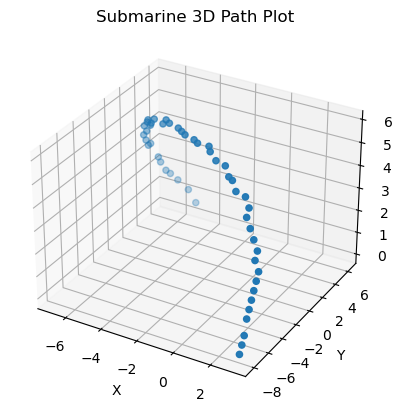

In [21]:
# plot path
import matplotlib.pyplot as plt

plotpath = plt.figure().add_subplot(projection='3d')
plotpath.scatter(path[0,:], path[1,:], path[2,:])

plotpath.set_title("Submarine 3D Path Plot")
plotpath.set_xlabel("X")
plotpath.set_ylabel("Y")
plotpath.set_zlabel("Z")

plt.savefig('Submarine3DPath.png')

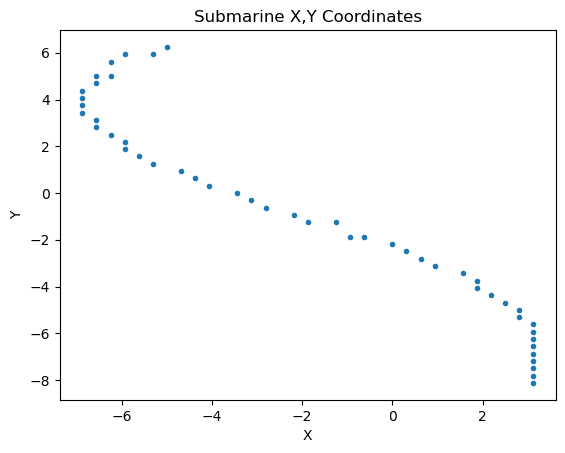

In [30]:
for i in range(49):
    time_steps = i*(24/49)
plt.scatter(path[0,:],path[1,:],marker='.')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Submarine X,Y Coordinates')
plt.savefig('Submarine2DPath')
plt.show()
